# Overview
This notebook analyzes the 55 Cancri system by testing the 5-planet model, with a Gaussian process (GP) to model stellar activity. After the 5-planet model is constructed and analyzed, we demonstrate our post-hoc method of estimating jitter, and compare results to our 4-planet model. 

In order to run this notebook, you will need to download all of the python packages we use. The complete list of used packages can be found at the top of the "functions.py" file in the repository.

In [1]:
from functions import * # See functions.py for the list of used functions and packages

In [2]:
# Orbital parameters
f_mag = 1.0/(10.5*365.25) #This equals 1/3835.125 (Bourrier value: 1.0/3822.4)
f_rot = 1.0/(38.8) # From Bourrier et al. 2018
planet_b = 1.0/14.65314 # (Bourrier value: 1.0/14.6516)          
planet_c = 1.0/44.373 #(Bourrier value: 1.0/44.3989)             
planet_d = 1.0/4867  #(Bourrier value: 1.0/5574.2)               
planet_e = 1.0/0.7365478 #(Bourrier value: 1.0/0.73654737)       
planet_f = 1.0/260.91 #(Bourrier value: 1.0/259.88)              
lunar = 1.0/29.53

planets = [planet_b, planet_c, planet_d, planet_e, planet_f]

In [3]:
# Read in RV and S-index
inst_Bourrier  = np.loadtxt("data/Bourrier_RV.txt", dtype = str, usecols = (5), skiprows = 43)
t_Bourrier, RV_Bourrier, RVerr_Bourrier, S_Bourrier, Serr_Bourrier = np.loadtxt("data/Bourrier_RV.txt", usecols = (0, 1, 2, 3, 4), skiprows = 43, unpack = True ) # BINNED, TRENDED 
t_Bourrier = t_Bourrier + 2400000.0 # Shift to JD

# Sort by time index
t_Bourrier, RV_Bourrier, RVerr_Bourrier, inst_Bourrier = sort_time(t_Bourrier, RV_Bourrier, RVerr_Bourrier, inst_Bourrier)

# Construct the Keplerian model

Fit linear parameters:
Parameter                        Value     Error       
lin.offset_inst_HARPN       27391.0595  ±  0.0373      
lin.offset_inst_HARPS       27463.0762  ±  0.0481      
lin.offset_inst_HRS          28354.962  ±  0.226       
lin.offset_inst_KECK          -14.0313  ±  0.0434      
lin.offset_inst_LICK            2.0091  ±  0.0923      
lin.offset_inst_SOPHIE      27461.2180  ±  0.0982      
lin.offset_inst_TULL        -22557.388  ±  0.164       

loglikelihood = -1555297.8373726257


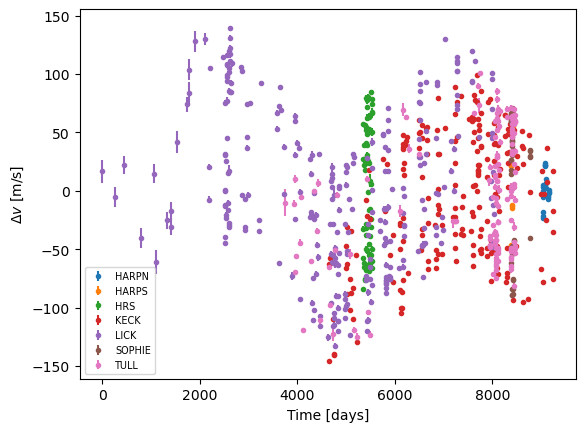

In [4]:
instruments = inst_Bourrier # Using my read-in method

fit_method = 'L-BFGS-B' 
fit_options = {
    'maxiter': 1000,
    'maxcor': 50
}
fit_ecc = True
fap_max = 1e-3 # FAP over this value terminates the agnostic DACE search

rv_model = rv.RvModel(t_Bourrier-t_Bourrier[0], RV_Bourrier, err = term.Error(RVerr_Bourrier))

# Construct a dictionary for the RV data
rv_dict = {}
rv_dict['jd'] = t_Bourrier-t_Bourrier[0] 
rv_dict['rv'] = RV_Bourrier
rv_dict['rv_err'] = RVerr_Bourrier
rv_dict['ins_name'] = instruments

# Add linear parameters
for inst in np.unique(instruments):
    rv_model.add_lin(1.0*(rv_dict['ins_name']==inst), f'offset_inst_{inst}') 

print("Fit linear parameters:")
rv_model.fit(method=fit_method, options=fit_options)
rv_model.show_param()
print('loglikelihood =', rv_model.loglike())

rv_err = np.sqrt(rv_model.cov.A)
plt.figure()
for inst in np.unique(instruments):
    kinst = rv_dict['ins_name'] == inst
    plt.errorbar(rv_dict['jd'][kinst],
        rv_dict['rv'][kinst] - rv_model.get_param(f'lin.offset_inst_{inst}'),
        yerr=rv_err[kinst],
        fmt='.', rasterized=True, label = inst)
plt.xlabel('Time [days]')
plt.ylabel('$\Delta v$ [m/s]')
plt.legend(loc = 'lower left', fontsize = 'x-small')
plt.show()

In [5]:
RR = 1./(max(rv_dict['jd'])-rv_dict['jd'][0]) # Rayleigh Resolution, to be used in frequency analysis
df = RR/2
f_N = 1./(2*np.median(np.diff(rv_dict['jd']))) # Nyquist frequency
f = np.arange(0, f_N, df)

In [6]:
# This function loops over the frequencies contained within the "signals" input array, fits Keplerians to each,
# and computes the resulting residual.
def remove_kep_without_jitter(RV_DICT, RV_MODEL, signals, fit_param = True):
    time, RV, rverr = RV_DICT['jd'],  RV_DICT['rv'], RV_DICT['rv_err']
    rv_model = RV_MODEL # Just redine for c/p reasons
    N = len(time)
    # Customize frequency array
    RR = 1./(max(time)-time[0])
    delta_f = RR/2
    f_N = 1./(2*np.median(np.diff(rv_dict['jd']))) # Nyquist frequency
    f = np.arange(0, f_N, delta_f)
    
    N_signals = len(signals)
    loglike = np.zeros(N_signals)
    LR = np.zeros(N_signals - 1)
    BIC = np.zeros(N_signals - 1)
    p_val = np.zeros(N_signals - 1)
    df = 5 # Degrees of freedom in Keplerian model 
    alpha = 0.01 # Critical p-value
    LR_cutoff = chi2.ppf(1-alpha, df) # Cutoff for LR hypothesis testing
    # Loop through, removing planets
    for passthrough in range(N_signals): 
        res = rv_model.residuals() # Update residual 
        rv_err = np.sqrt(rv_model.cov.A)

        # Plot the RV residual scatterplot 
        plot_residual(RV_DICT, res, rv_model, passthrough)     
        fls, pls, GLS_window, percentiles = GLS_calc(time, res, bootstrap = True) 

        # Plot the GLS periodogram of the residual
        plot_GLS(fls, pls, percentiles, passthrough)
        
        print('Removing orbit of P={} d \n'.format(1.0/signals[passthrough])) 
        rv_model.add_keplerian_from_period((1.0/signals[passthrough]), fit = True)
        rv_model.set_keplerian_param(f'{rv_model.nkep-1}', param=['P', 'la0', 'K', 'e', 'w'])
        if not fit_ecc:
            rv_model.set_param(np.zeros(2), rv_model.fit_param[-2:])
            rv_model.fit_param = rv_model.fit_param[:-2]
        # Global fit of the model
        if fit_param:
            print("Fitting model parameters: ")
            rv_model.fit(method=fit_method, options=fit_options)
        rv_model.show_param()
        print('loglikelihood = {}\n'.format(rv_model.loglike()))
        #print("Residual RMS: ", np.sqrt(np.mean(res**2)))
        #print("Residual Chi^2: ", rv_model.chi2())
        loglike[passthrough] = rv_model.loglike()
        
    # After the final iteration of the loop, plot the final resiudal scatter plot and GLS
    res = rv_model.residuals() # Final Update of residual 
    rv_err = np.sqrt(rv_model.cov.A)

    fls, pls, GLS_window, percentiles = GLS_calc(time, res, bootstrap = True)

    plot_residual(RV_DICT, res, rv_model, (passthrough+1))
    plot_GLS(fls, pls, percentiles, passthrough+1)
    
    # Compute Likelihood Ratio test for the nested planetary models
    for i in range(len(LR)):
        LR[i] = 2*(loglike[i+1] - loglike[i]) # Order is less restrictive model minus more restrictive (more params - less params) 
        p_val[i] = chi2.sf(LR[i], df) # 1 - cdf  
        BIC[i] = len(rv_model.get_param())*np.log(len(RV)) - 2*loglike[i]
    
    print("LR cutoff for significance: ", LR_cutoff)
    print("\t ~~ 55Cnc No Jitter ~~", "\nloglike : ", loglike, "\nLR = ", LR, "\n")
    print("p-values: ", p_val, "\n")
    print("Bayesian information criterion: ", BIC)
    
    return rv_model, res, loglike, LR, p_val

Let's compute the 5-Keplerian model. 5 instances of bootstrapped FALs in the periodograms will take some time. $P = 391 = N/2$ days is a spectral window artifact.

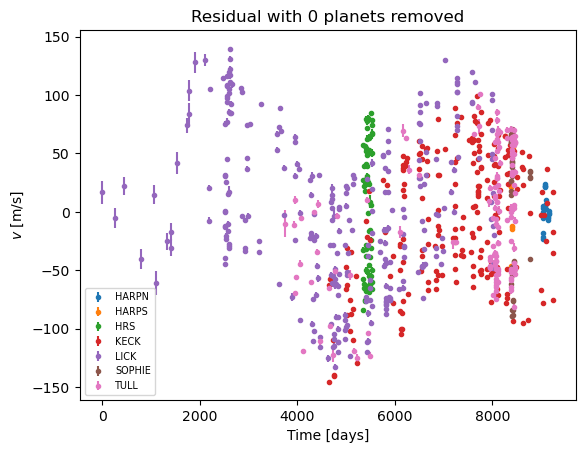

0.0
0.1
0.2
0.4
0.8
Bootstrap took 100.73886609077454 s for 10000 iterations


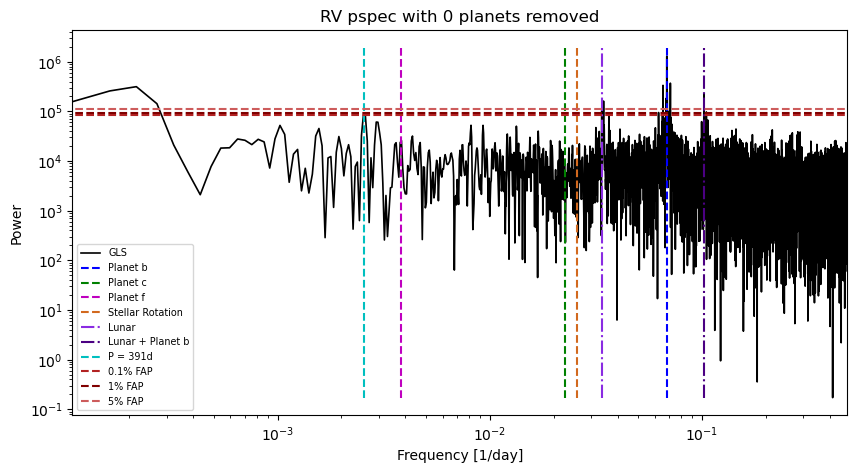

Removing orbit of P=14.653140000000002 d 

Fitting model parameters: 
Parameter                        Value     Error       
lin.offset_inst_HARPN       27440.5723  ±  0.0503      
lin.offset_inst_HARPS       27479.3079  ±  0.0608      
lin.offset_inst_HRS          28357.591  ±  0.226       
lin.offset_inst_KECK          -23.7175  ±  0.0448      
lin.offset_inst_LICK            4.7905  ±  0.0926      
lin.offset_inst_SOPHIE      27449.1494  ±  0.0995      
lin.offset_inst_TULL        -22558.505  ±  0.164       
kep.0.P                     14.6523452  ±  0.0000153   
kep.0.la0 [deg]                336.564  ±  0.204       
kep.0.K                        69.4968  ±  0.0449      
kep.0.e                       0.023049  ±  0.000541    
kep.0.w [deg]                   203.78  ±  1.33        

loglikelihood = -262917.29213645123



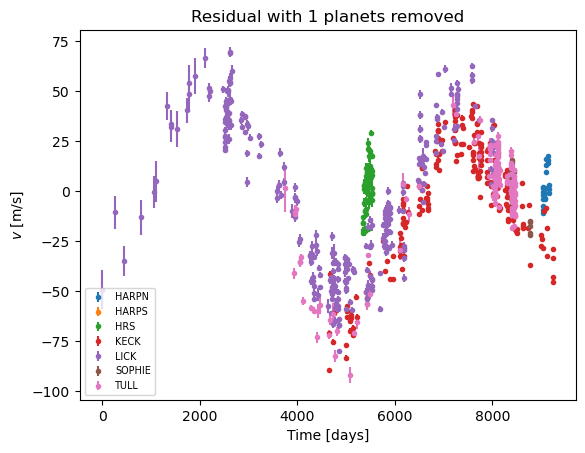

0.0
0.1
0.2
0.4
0.8
Bootstrap took 98.70048522949219 s for 10000 iterations


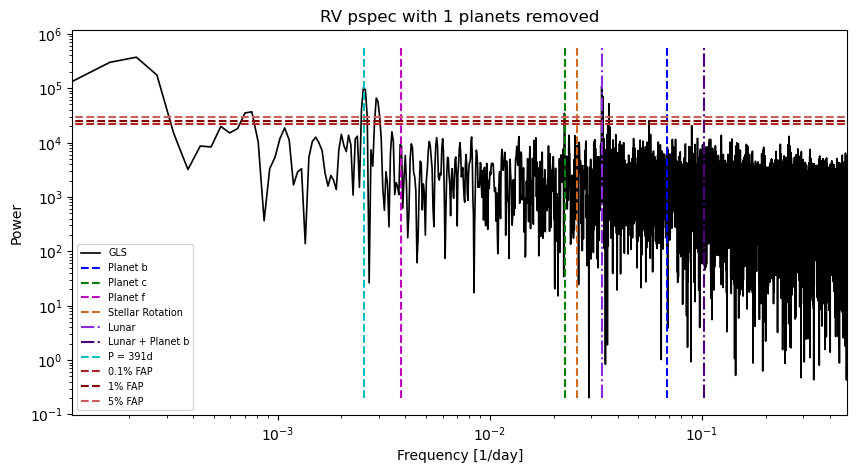

Removing orbit of P=44.373 d 

Fitting model parameters: 
Parameter                        Value     Error       
lin.offset_inst_HARPN        27444.636  ±  0.119       
lin.offset_inst_HARPS       27478.4958  ±  0.0821      
lin.offset_inst_HRS          28356.379  ±  0.231       
lin.offset_inst_KECK          -23.2234  ±  0.0575      
lin.offset_inst_LICK             4.520  ±  0.101       
lin.offset_inst_SOPHIE       27446.327  ±  0.101       
lin.offset_inst_TULL        -22557.963  ±  0.164       
kep.0.P                     14.6517643  ±  0.0000199   
kep.0.la0 [deg]                329.838  ±  0.259       
kep.0.K                        68.7014  ±  0.0481      
kep.0.e                       0.018235  ±  0.000569    
kep.0.w [deg]                   114.89  ±  2.37        
kep.1.P                       44.36852  ±  0.00368     
kep.1.la0 [deg]                 318.35  ±  5.45        
kep.1.K                        10.7063  ±  0.0665      
kep.1.e                         0.3585  ±  0.0

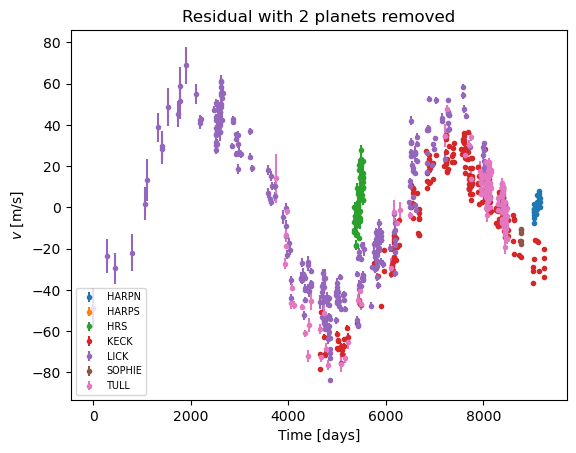

0.0
0.1
0.2
0.4
0.8
Bootstrap took 96.31640338897705 s for 10000 iterations


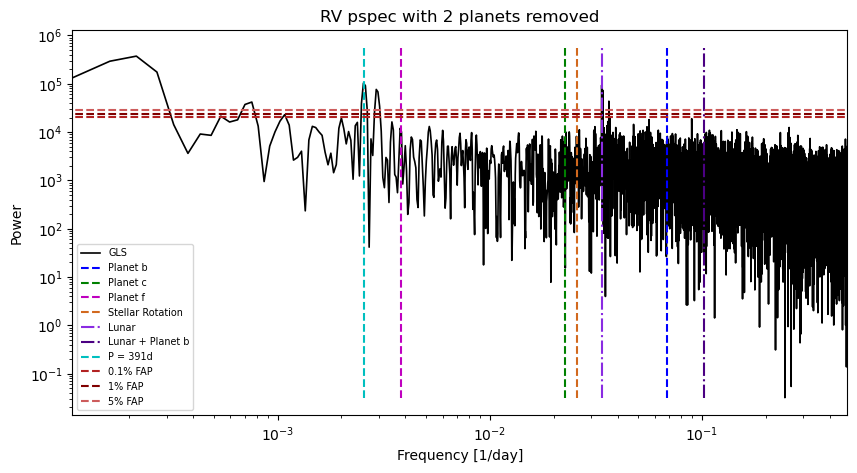

Removing orbit of P=260.91 d 

Fitting model parameters: 


/home/justin/anaconda3/envs/freshstart/lib/python3.10/site-packages/kepmodel/timeseries.py:716: RuntimeWarning: invalid value encountered in sqrt
  error = np.sqrt(-np.diag(np.linalg.inv(hess)))


Parameter                        Value     Error       
lin.offset_inst_HARPN       27447.2918  ±  0.0632      
lin.offset_inst_HARPS       27475.3913  ±  0.0694      
lin.offset_inst_HRS          28357.348  ±  0.227       
lin.offset_inst_KECK          -22.5203  ±  0.0437      
lin.offset_inst_LICK            4.0621  ±  0.0930      
lin.offset_inst_SOPHIE       27443.449  ±  0.102       
lin.offset_inst_TULL        -22557.678  ±  0.164       
kep.0.P                     14.6516854  ±  0.0000158   
kep.0.la0 [deg]                327.377  ±  0.207       
kep.0.K                        68.8336  ±  0.0462      
kep.0.e                       0.024540  ±  0.000552    
kep.0.w [deg]                   128.31  ±  1.33        
kep.1.P                       44.46008  ±  0.00104     
kep.1.la0 [deg]                  94.44  ±  1.52        
kep.1.K                        10.2263  ±  0.0404      
kep.1.e                        0.18287  ±  0.00365     
kep.1.w [deg]                   141.14  ±  1.28 

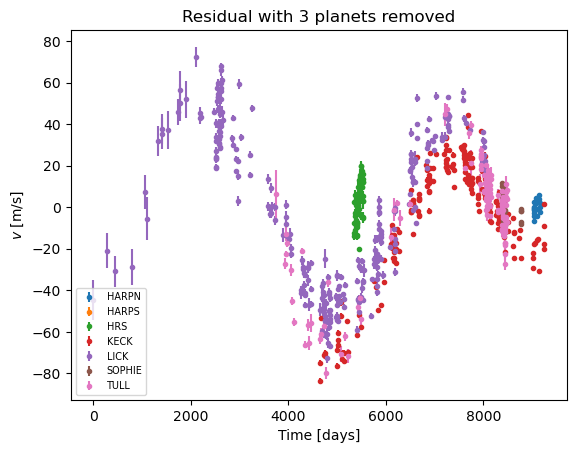

0.0
0.1
0.2
0.4
0.8
Bootstrap took 99.21420550346375 s for 10000 iterations


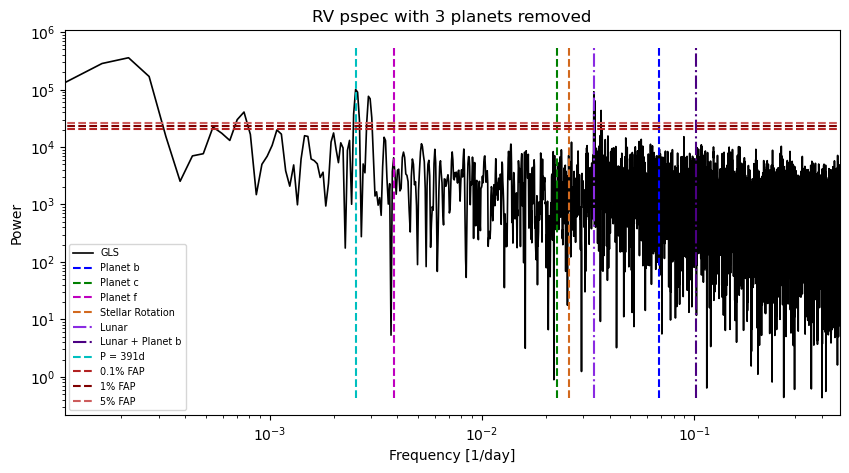

Removing orbit of P=0.7365478 d 

Fitting model parameters: 
Parameter                        Value     Error       
lin.offset_inst_HARPN       27445.4842  ±  0.0694      
lin.offset_inst_HARPS       27473.4502  ±  0.0766      
lin.offset_inst_HRS          28357.368  ±  0.227       
lin.offset_inst_KECK          -22.4317  ±  0.0439      
lin.offset_inst_LICK            3.7851  ±  0.0933      
lin.offset_inst_SOPHIE       27441.565  ±  0.107       
lin.offset_inst_TULL        -22557.928  ±  0.165       
kep.0.P                     14.6517655  ±  0.0000159   
kep.0.la0 [deg]                328.531  ±  0.209       
kep.0.K                        69.0084  ±  0.0464      
kep.0.e                       0.025377  ±  0.000551    
kep.0.w [deg]                   129.28  ±  1.28        
kep.1.P                       44.45957  ±  0.00103     
kep.1.la0 [deg]                  93.70  ±  1.50        
kep.1.K                        10.3062  ±  0.0403      
kep.1.e                        0.17643  ±  

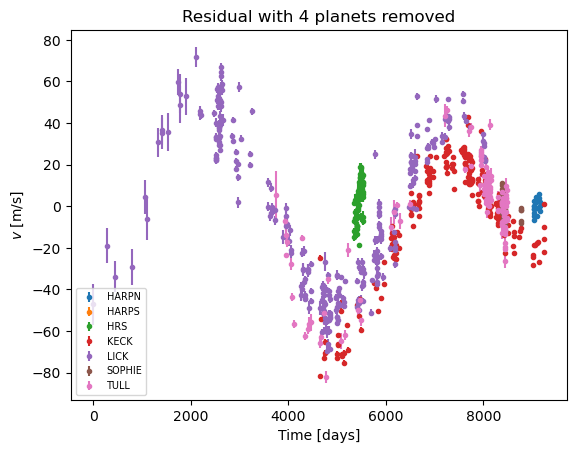

0.0
0.1
0.2
0.4
0.8
Bootstrap took 95.99604082107544 s for 10000 iterations


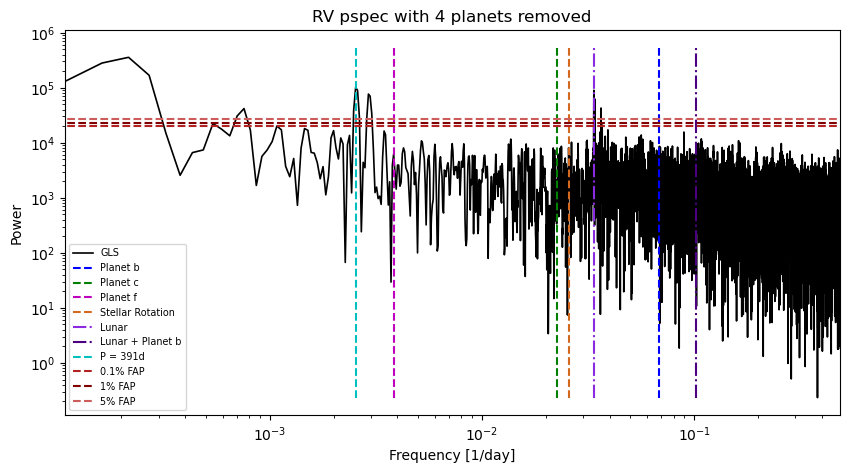

Removing orbit of P=4867.0 d 

Fitting model parameters: 
Parameter                        Value     Error       
lin.offset_inst_HARPN        27459.218  ±  0.158       
lin.offset_inst_HARPS        27460.000  ±  0.150       
lin.offset_inst_HRS          28395.260  ±  0.259       
lin.offset_inst_KECK          -42.6174  ±  0.0762      
lin.offset_inst_LICK            0.7857  ±  0.0959      
lin.offset_inst_SOPHIE       27430.713  ±  0.164       
lin.offset_inst_TULL        -22576.028  ±  0.181       
kep.0.P                     14.6513954  ±  0.0000153   
kep.0.la0 [deg]                324.729  ±  0.203       
kep.0.K                        71.0776  ±  0.0470      
kep.0.e                       0.006467  ±  0.000549    
kep.0.w [deg]                    90.18  ±  5.16        
kep.1.P                       44.42064  ±  0.00103     
kep.1.la0 [deg]                  37.29  ±  1.48        
kep.1.K                        10.1576  ±  0.0377      
kep.1.e                        0.04614  ±  0.0

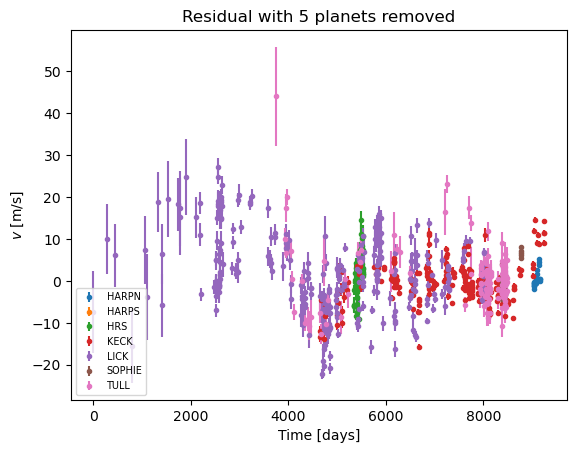

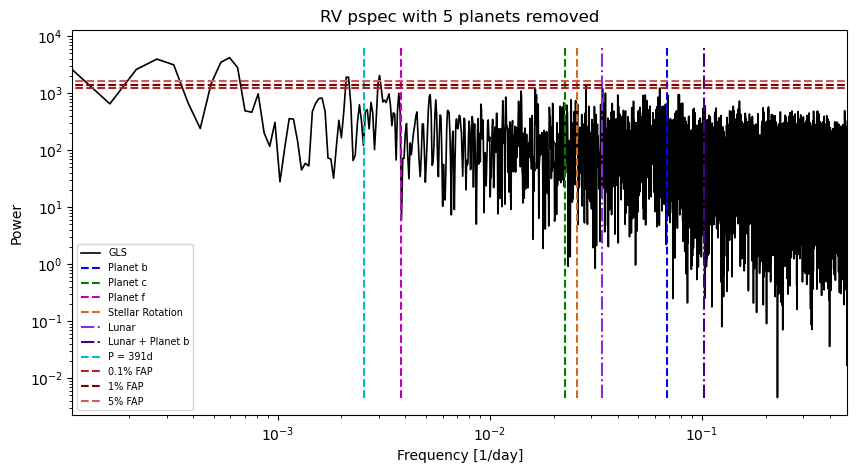

LR cutoff for significance:  15.08627246938899
	 ~~ 55Cnc No Jitter ~~ 
loglike :  [-262917.29213645 -221290.61866872 -205447.72045529 -201799.8330196
  -12207.15100908] 
LR =  [ 83253.34693547  31685.79642685   7295.77487138 379185.36402106] 

p-values:  [0. 0. 0. 0.] 

Bayesian information criterion:  [526047.7636246  442794.41668913 411108.62026228 403812.84539091]


In [7]:
model_5pGP, res, loglike, LR, p_val = remove_kep_without_jitter(rv_dict, rv_model, [planet_b, planet_c, planet_f, planet_e, planet_d], fit_param = True)

In [8]:
time = rv_dict['jd'] - rv_dict['jd'][0]; RV = RV_Bourrier; RVerr = RVerr_Bourrier 
unif_time = np.linspace(time[0], np.max(time), round(len(time)/3)) 
kep_model = model_5pGP
N_param = len(rv_model.get_param())

metric_guess = 17.0 
gamma_guess = 1.0 
period_guess = np.exp(8.55) 

# Set reasonable boundaries for each hyperparameter
# Parameter order: ln(amplitude), ln(metric^2), gamma, ln(period)
GP_lower_bounds = [0.5, np.log(2000.0**2), 0.01, np.log(1500.0)]  
GP_upper_bounds = [5.8, 22.0, 10.0, 8.8] 
model_values = np.array(kep_model.get_param())
model_errors = np.array(kep_model.get_param_error()[1])

# Fix the nan in uncertanties to Bourrier et al (2018) value
model_errors[N_param-10] = 1.3*10**(-6) 

# Vastly increasing parameter error bars to allow GP to explore more space
# (This only affects instrumental offset bounds; kep param bounds fixed below)
kep_lower_bounds = model_values - 1000.0*model_errors
kep_upper_bounds = model_values + 1000.0*model_errors

for p in range(5):
    kep_lower_bounds[7 + int(5*p) + 1] = 0.0 # Mean longitude
    kep_lower_bounds[7 + int(5*p) + 3] = 0.0 # eccentricity
    kep_lower_bounds[7 + int(5*p) + 4] = 0.0 # argument of periastron
    
    kep_upper_bounds[7 + int(5*p) + 1] = 360.0 # Mean longitude
    kep_upper_bounds[7 + int(5*p) + 3] = 0.7 # eccentricity
    kep_upper_bounds[7 + int(5*p) + 4] = 360.0 # argument of periastron

# Fix amplitude bounds 
kep_lower_bounds[16-7] = 60.0; kep_upper_bounds[16-7] = 80.0 # Amplitude of planet b
kep_lower_bounds[21-7] = 2.0; kep_upper_bounds[21-7] = 20.0 # Amplitude of planet c
kep_lower_bounds[26-7] = 2.0; kep_upper_bounds[26-7] = 20.0 # Amplitude of planet f
kep_lower_bounds[26-9] = 200.0; kep_upper_bounds[26-9] = 300.0 # Period of planet f
kep_lower_bounds[31-7] = 2.0; kep_upper_bounds[31-7] = 20.0 # Amplitude of planet e
kep_lower_bounds[N_param - 3] = 10.0; kep_upper_bounds[N_param - 3] = 50.0 # Amplitude of planet d
kep_lower_bounds[N_param - 5] = 1500.0; kep_upper_bounds[N_param - 5] = 6500.0 # Period of planet d 

par_bounds = Bounds(combine_kep_GP_params(kep_lower_bounds, GP_lower_bounds), combine_kep_GP_params(kep_upper_bounds, GP_upper_bounds))
    
k_exp2 = np.std(kep_model.residuals()) * kernels.ExpSquaredKernel(metric = metric_guess) 
k_per = kernels.ExpSine2Kernel(gamma = gamma_guess, log_period = np.log(period_guess))
k_mag = k_exp2 * k_per

# The below guess parameters are prior Nelder-Mead results
guess_pars_no_jitter = [ 2.74550055e+04,  2.74691022e+04,  2.83974958e+04, -3.94343675e+01,
  4.24743467e+00,  2.74390579e+04, -2.25703040e+04,  1.46515548e+01,
  5.70595877e+00,  7.12624543e+01,  7.69216943e-04, 3.91169320e+00,
  4.44030098e+01,  1.79906272e-01,  9.72853639e+00,  3.43073964e-02,
  6.52905190e+00,  2.59874924e+02,  5.12012594e+00,  5.22035182e+00,
  2.36240133e-01,  5.34052387e+00,  7.36548081e-01,  1.94569550e+00,
  6.01660310e+00,  3.27734161e-02,  2.07926296e+00,  5.62084890e+03,
  3.58342626e+00,  2.45989628e+01,  3.82921437e-01,  4.92326155e+00,
  3.47449588e+00,  1.64768058e+01,  3.03392484e+00,  8.42431518e+00]

gp_irregular = george.GP(k_mag, mean = np.mean(kep_model.residuals()), fit_kernel = True)
gp_irregular.set_parameter_vector(guess_pars_no_jitter[len(guess_pars_no_jitter)-4:])
gp_irregular.compute(time, RVerr)

Below is my previous best fit GP for the 5 planet model

In [9]:
for i in range(len(kep_lower_bounds)):
    print("Min | Initial Value | Max : ", kep_lower_bounds[i], "|", guess_pars_no_jitter[i], "|", kep_upper_bounds[i])

Min | Initial Value | Max :  27301.09865381575 | 27455.0055 | 27617.33770768819
Min | Initial Value | Max :  27310.0282411373 | 27469.1022 | 27609.971162289065
Min | Initial Value | Max :  28136.17475011404 | 28397.4958 | 28654.34443994912
Min | Initial Value | Max :  -118.78867099043451 | -39.4343675 | 33.55377966284321
Min | Initial Value | Max :  -95.11071606518351 | 4.24743467 | 96.68219007535328
Min | Initial Value | Max :  27266.79707516103 | 27439.0579 | 27594.62861882425
Min | Initial Value | Max :  -22757.471279995272 | -22570.304 | -22394.583728498266
Min | Initial Value | Max :  14.636069880612531 | 14.6515548 | 14.66672087347186
Min | Initial Value | Max :  0.0 | 5.70595877 | 360.0
Min | Initial Value | Max :  60.0 | 71.2624543 | 80.0
Min | Initial Value | Max :  0.0 | 0.000769216943 | 0.7
Min | Initial Value | Max :  0.0 | 3.9116932 | 360.0
Min | Initial Value | Max :  43.3953213655894 | 44.4030098 | 45.44595766323891
Min | Initial Value | Max :  0.0 | 0.179906272 | 360.0


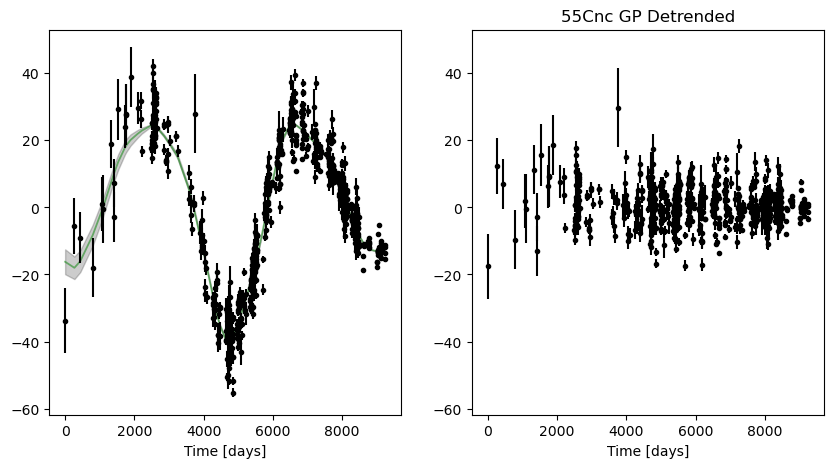

In [10]:
kep_model.set_param(guess_pars_no_jitter[0:len(guess_pars_no_jitter)-4])

gp_irregular.set_parameter_vector(guess_pars_no_jitter[len(guess_pars_no_jitter)-4:]) 
gp_irregular.compute(time, RVerr)

t_GP_TEST, GP_fit_TEST = plot_GP(gp_irregular, gp_irregular.get_parameter_vector(), time, kep_model.residuals(), RVerr)

# The GP Model 

To model stellar activity, we construct a quasiperiodic GP kernel as informed by Equation 27 from Rajpaul et al. (2015):
\begin{equation}
    k_{\text{QP}}(t_i, t_j) = K^2 \text{exp}\Bigg\{ - \frac{ \sin^2{[\pi(t_i - t_j)/P]}}{2 \lambda_p^2} - \frac{(t_i - t_j)^2}{2 \lambda_e^2}  \Bigg\} , 
\label{eq:GP_ker}
\end{equation}
where $K$ is the amplitude, $P$ is the period of oscillation, $\lambda_p$ is the dimensionless length scale of periodic variation (often called a correlation time scale), and $\lambda_e$ is an evolutionary time scale in the units of $t$. The first term captures periodic variation through the non-stationary exponential-sine-squared kernel and amplitude modulation though the stationary exponential-squared kernel. 

Our model fitting is through a curvature-penalized likelihood function $\mathcal{L}(\boldsymbol{\theta})$ given input parameters $\boldsymbol{\theta}$:
\begin{equation}
\mathcal{L}(\boldsymbol{\theta}) = -\frac{1}{2} \sum^{N-1}_{n = 0}  \frac{(\Delta y_n - \tau_n)^2}{\sigma_{y, n}^2}  - \frac{1}{2} \alpha \sum^{M}_{m = 1} \Bigg( \frac{\tau_{m+1} - 2\tau_m + \tau_{m-1}}{\Delta t_{\text{GP}}^2} \Bigg)^2
\end{equation}
where $\Delta y_n$ is the Keplerian residual and $\tau_n$ is the stellar activity induced Doppler shift predicted by $k_{\text{QP}}$ at time $t_n$. $\alpha$ dictates the degree to which GP curvature is penalized.

# Try Nelder-Mead using curvature-penalized NLL 
You can play around with Nelder-Mead optimization using the code below. We ultimately ran both Nelder-Mead and MCMC code on the University of Delaware Caviness computing cluster. The MCMC script can be found in the main repository branch, and is appropriately labeled.

In [11]:
par_bounds = Bounds(combine_kep_GP_params(kep_lower_bounds, GP_lower_bounds), combine_kep_GP_params(kep_upper_bounds, GP_upper_bounds))

alpha = 3.0e9 
def penalized_NLL(all_params):
    kep_params, GP_params = split_kep_gp(all_params)
    kep_model.set_param(kep_params)
    kepres = kep_model.residuals() # Update residual 
    gp_irregular.set_parameter_vector(GP_params)    

    # Compute mean GP prediction
    GP_pred_unif, pred_var_unif = gp_irregular.predict(kepres, unif_time, return_var = True) 
    GP_pred_irregular, pred_var_irregular = gp_irregular.predict(kepres, time, return_var = True)
    
    deriv_sum = (second_deriv(unif_time, GP_pred_unif)**2).sum()
    obj = -0.5*((kepres-GP_pred_irregular)**2/RVerr_Bourrier**2).sum() - 0.5*alpha*deriv_sum
    return -obj if np.isfinite(obj) else 1e25

def penalized_NLL_PRINTMODE(all_params): # Same as above, just prints out the values of the two terms in the obj func
    kep_params, GP_params = split_kep_gp(all_params)
    kep_model.set_param(kep_params)
    kepres = kep_model.residuals() # Update residual 
    gp_irregular.set_parameter_vector(GP_params)    

    # Compute mean GP prediction
    GP_pred_unif, pred_var_unif = gp_irregular.predict(kepres, unif_time, return_var = True) 
    GP_pred_irregular, pred_var_irregular = gp_irregular.predict(kepres, time, return_var = True)
    
    deriv_sum = (second_deriv(unif_time, GP_pred_unif)**2).sum()
    obj = -0.5*((kepres-GP_pred_irregular)**2/RVerr_Bourrier**2).sum() - 0.5*alpha*deriv_sum
    
    print("LSQ term = ", -0.5*((kepres-GP_pred_irregular)**2/RVerr_Bourrier**2).sum())
    print("Curvature term = ", - 0.5*alpha*deriv_sum)
    print("alpha = ", alpha)
    return -obj if np.isfinite(obj) else 1e25

print("\nBeginning O(p) =  {0:.2f}".format(penalized_NLL(guess_pars_no_jitter)))
print("LAST RUN GP params: ")
print("Fitted GP period [days]: ", np.exp(guess_pars_no_jitter[len(guess_pars_no_jitter)-1]))
print("GP decor. timescale [days]: ", np.sqrt(np.exp(guess_pars_no_jitter[len(guess_pars_no_jitter)-3])) ) 
print("Fitted GP amplitude [m/s]: ", np.exp(guess_pars_no_jitter[len(guess_pars_no_jitter)-4]))
optimize = False
if optimize:
    print(penalized_NLL_PRINTMODE(guess_pars_no_jitter))
    start = timer.time()
    result = minimize(penalized_NLL,  guess_pars_no_jitter, method="Nelder-Mead", bounds = par_bounds, 
                          options = {'disp': True, 'maxfev': 2000})
    end = timer.time()
    print("Optimization took ", (end-start)/60.0, "min")
    print("\nFinal O(p) =  {0:.2f}".format(penalized_NLL(result.x)))
    print(penalized_NLL_PRINTMODE(result.x))

    print("=========Optimized Parameters=========\n", result.x)
    print("Fitted GP period [days]: ", np.exp(result.x[len(result.x)-1]))
    print("GP decor. timescale [days]: ", np.sqrt(np.exp(result.x[len(result.x)-3])) ) 
    print("Fitted GP amplitude [m/s]: ", np.exp(result.x[len(result.x)-4]))
    print("Success?: ", result.success)
    #print(result.x)


Beginning O(p) =  7094.93
LAST RUN GP params: 
Fitted GP period [days]:  4556.523311404423
GP decor. timescale [days]:  3783.4928638165625
Fitted GP amplitude [m/s]:  32.28155065863546


# MCMC Results
We computed MCMC results using the University of Delaware Caviness cluster, and simply read in the resulting chains for further analysis. See "55Cnc_5pGP_MCMC_alpha_3e9_final.py" for the MCMC code.

In [12]:
chains_3e9_newamp = np.loadtxt('caviness/55Cnc_5pGP_MCMC_chains_alpha_3000000000_newamp.txt')

Let's investigate the MCMC results for the curvature penalty we end up using for this model: $\alpha = 3\cdot10^9$.

Maximum IAT: 551.7498454833271
Effective Number of Samples per param: [ 767.20123253  764.07366752  765.93773199  764.36961417  766.11266101
  765.33234037  765.26614052 1046.63458387 1040.81717197 1100.8658704
  931.41561699  483.31323005 1161.1975855  1191.91847251 1045.41438541
 1191.88294271 1094.02117627 1075.31828504 1095.86914604 1068.34803625
 1059.73412096  925.08351641 1123.52589215 1093.27117724 1067.42960853
 1031.01223004 1074.23034107 1027.16139579 1032.37848125  960.58884413
 1118.09163812 1081.04230016  834.83085475  735.73379505  888.82336795
  907.07192715]
Mean ESS:  967.9255383856726
Minimum ESS:  483.3132300497549


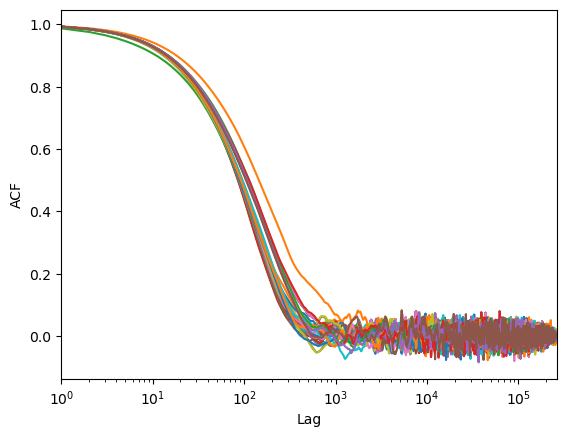

In [13]:
nsamples = 400000
alpha = 3.0e9
samples = chains_3e9_newamp.reshape((nsamples+1, 5*5+7+4)) # 25 kep params, 7 inst offsets, 4 GP params

burn = nsamples//3
R = acf.acf(samples[burn:, :])
tau = np.arange(R.shape[0])
plt.figure()
plt.plot(tau[1:], R[1:])
plt.xscale('log')
plt.xlim(1, tau[-1])
plt.xlabel('Lag')
plt.ylabel('ACF')
iat = acf.iat(R=R)
iat_max = np.max(acf.iat(R=R))
ESS = R.shape[0]/iat

print('Maximum IAT:', iat_max) # Time needed for chain to forget where it started
print('Effective Number of Samples per param:', ESS) # N/iat
print("Mean ESS: ", np.mean(ESS))
print("Minimum ESS: ", np.min(ESS))

In [14]:
# Set up labels for corner plot
corner_labels = ["HARPN "+"$\Delta v$", "HARPS "+"$\Delta v$", "HRS "+"$\Delta v$", "KECK "+"$\Delta v$", "LICK "+"$\Delta v$", "SOPHIE "+"$\Delta v$", "TULL "+"$\Delta v$"]
for p in range(5): 
    if p==0:
        corner_labels.append("(B) "+"$P$") 
        corner_labels.append("(B) "+"$L_0$")
        corner_labels.append("(B) "+"$K$")
        corner_labels.append("(B) "+"$e$")
        corner_labels.append("(B) "+"$\omega$")
    elif p==1:
        corner_labels.append("(C) "+"$P$") 
        corner_labels.append("(C) "+"$L_0$")
        corner_labels.append("(C) "+"$K$")
        corner_labels.append("(C) "+"$e$")
        corner_labels.append("(C) "+"$\omega$")
    elif p==2:
        corner_labels.append("(F) "+"$P$") 
        corner_labels.append("(F) "+"$L_0$")
        corner_labels.append("(F) "+"$K$")
        corner_labels.append("(F) "+"$e$")
        corner_labels.append("(F) "+"$\omega$")       
    elif p==3:
        corner_labels.append("(E) "+"$P$") 
        corner_labels.append("(E) "+"$L_0$")
        corner_labels.append("(E) "+"$K$")
        corner_labels.append("(E) "+"$e$")
        corner_labels.append("(E) "+"$\omega$")
    elif p==4:
        corner_labels.append("(D) "+"$P$") 
        corner_labels.append("(D) "+"$L_0$")
        corner_labels.append("(D) "+"$K$")
        corner_labels.append("(D) "+"$e$")
        corner_labels.append("(D) "+"$\omega$")
corner_labels.append("$\ln{(K)}$")
corner_labels.append("  $\ln{(\lambda_{e}^2)}$")
corner_labels.append("$1/2\lambda_{p}^2$")
corner_labels.append("  $P$") 

Burn-in:  133333


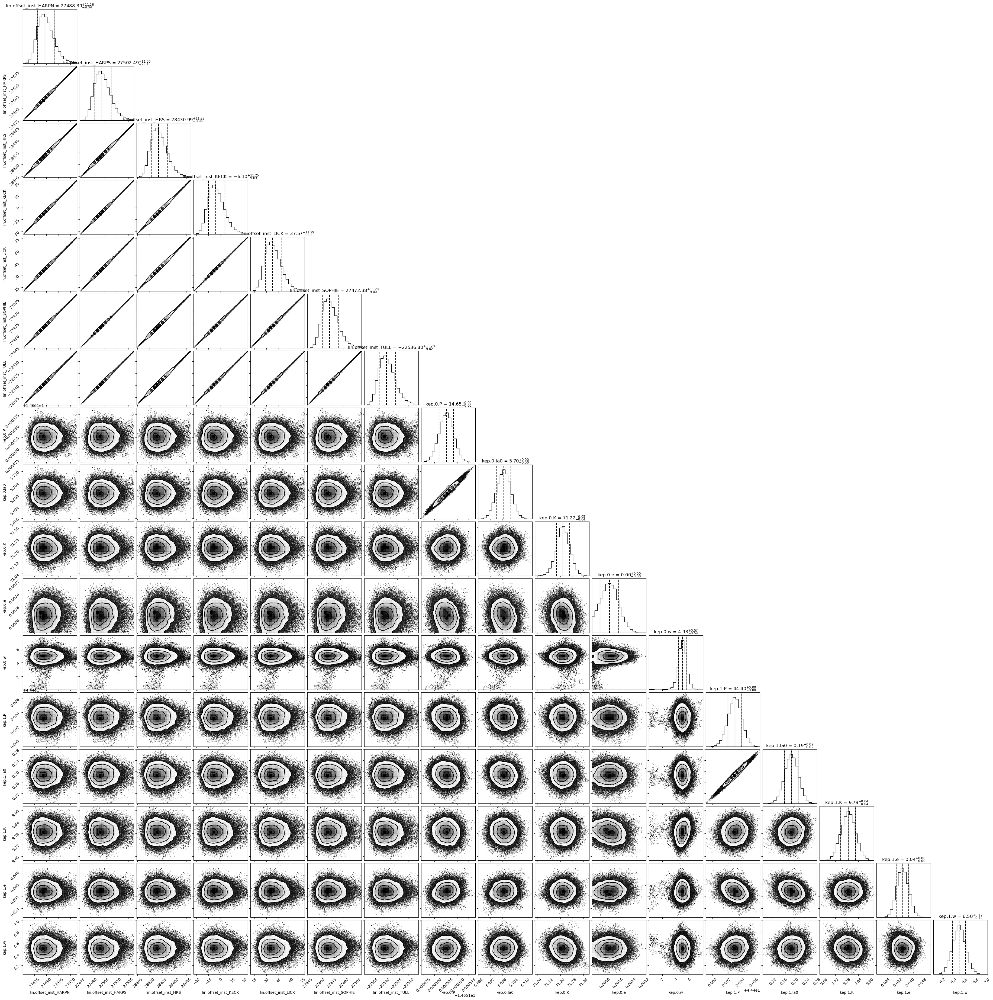

In [15]:
# Corner plot of only the instrumentation effects + a couple planets
print("Burn-in: ", burn)
corner.corner(
    samples[burn:, 0:17], #samples[nsamples//4:, 19:],
    labels=kep_model.fit_param[0:17], #corner_labels[0:17], #kep_model.fit_param[0:17],
    quantiles=[0.159, 0.5, 0.841],
    show_titles=True)
plt.show()
plt.close()

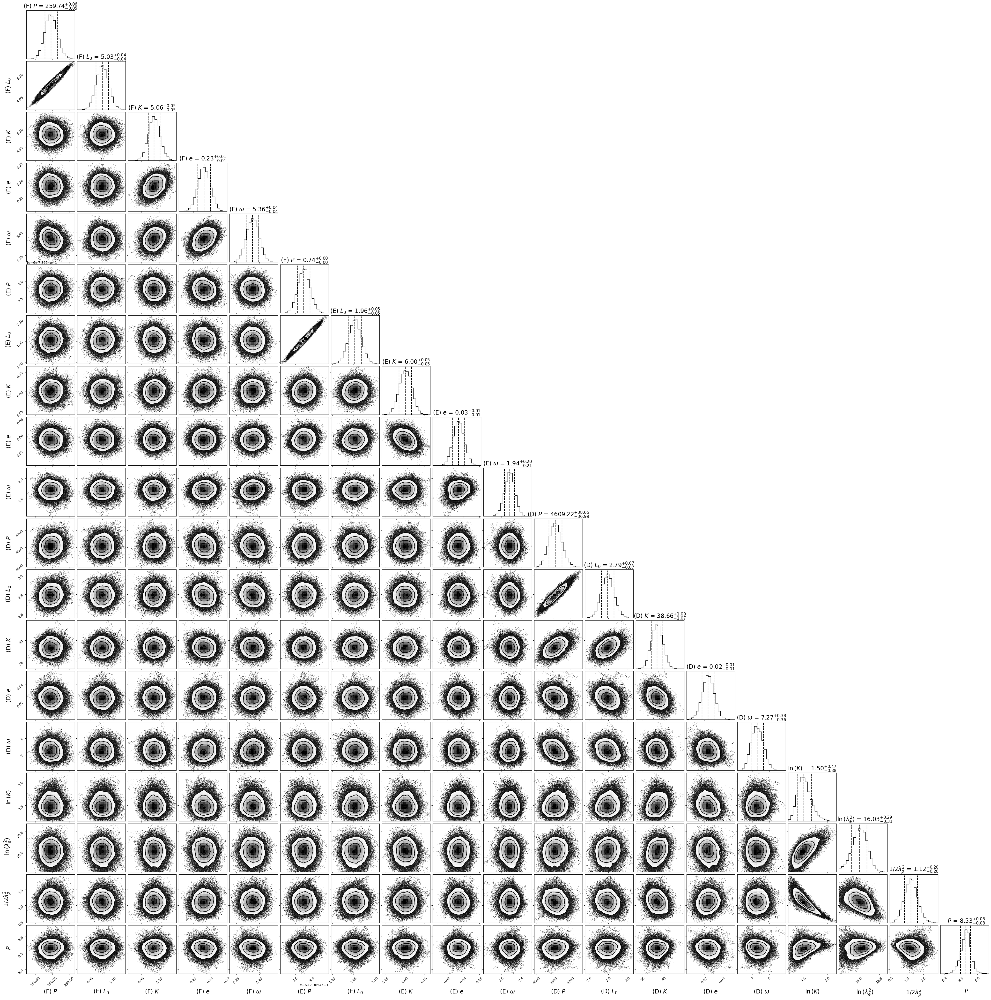

In [16]:
label_dict = {}; label_dict["fontsize"] = "xx-large"
title_kwargs = {}; title_kwargs["fontsize"] = "xx-large"
corner.corner(
    samples[burn:, 17:], 
    labels=corner_labels[17:],
    quantiles=[0.159, 0.5, 0.841],
    show_titles=True, max_n_ticks=3, label_kwargs = label_dict, title_kwargs = title_kwargs)
plt.show()
plt.close()

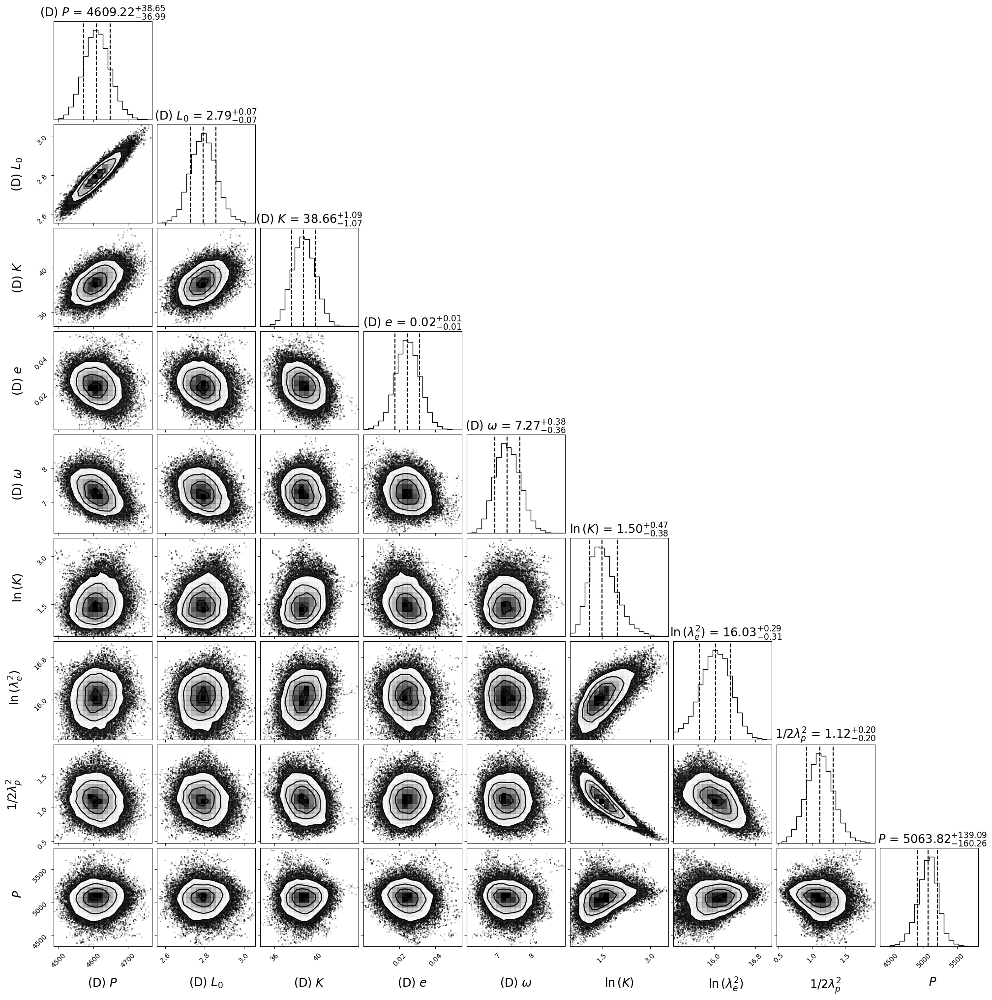

In [17]:
label_dict = {}; label_dict["fontsize"] = "xx-large"
title_kwargs = {}; title_kwargs["fontsize"] = "xx-large"

mod_samples = np.zeros(np.shape(samples[burn:, len(guess_pars_no_jitter)-9:]))
mod_samples[:, 0:8] = samples[burn:, len(guess_pars_no_jitter)-9:len(guess_pars_no_jitter)-1]
mod_samples[:, 8] = np.exp(samples[burn:, len(guess_pars_no_jitter)-1])

corner.corner(
    mod_samples, 
    labels=corner_labels[len(guess_pars_no_jitter)-9:],
    quantiles=[0.159, 0.5, 0.841],
    show_titles=True, max_n_ticks=3, label_kwargs = label_dict, title_kwargs = title_kwargs)
plt.show()
plt.close()

Our final model parameters from the MCMC posterior distributions:

In [18]:
# obtain uncertanties using [0.159, 0.5, 0.841] quantiles on the MCMC chains
quantiles = np.zeros((np.shape(samples[0, :])[0], 3))
for i in range(np.shape(samples[0, :])[0]):
    quantiles[i, :] = corner.quantile(samples[burn:, i], [0.159, 0.5, 0.841], weights=None)
    print(i, ": ", quantiles[i, 1], "(+ ", quantiles[i, 2]-quantiles[i, 1], ") (- ", quantiles[i, 1]-quantiles[i, 0], ")")

0 :  27488.38957715069 (+  11.304191589541006 ) (-  9.078048836330709 )
1 :  27502.486276775937 (+  11.362112521281233 ) (-  9.044625536163949 )
2 :  28430.99397335553 (+  11.319054280207638 ) (-  9.026785477359226 )
3 :  -6.102275418085083 (+  11.332459882627216 ) (-  9.057628666222467 )
4 :  37.56698329407778 (+  11.351883667726504 ) (-  9.04652353874414 )
5 :  27472.377558389893 (+  11.343730845281243 ) (-  9.032226064151473 )
6 :  -22536.800110376866 (+  11.350454810057272 ) (-  9.052363946706464 )
7 :  14.651525740877288 (+  1.5620207754807325e-05 ) (-  1.5850823995577912e-05 )
8 :  5.698829560393462 (+  0.003573837208618258 ) (-  0.0036581354938549637 )
9 :  71.21749925121856 (+  0.047372793673901015 ) (-  0.04442997803818116 )
10 :  0.0010784307827917362 (+  0.0005674337162226535 ) (-  0.0005712749501044364 )
11 :  4.931311715019698 (+  0.5723796039028741 ) (-  0.5916880095228594 )
12 :  44.40328000938992 (+  0.0009866861340483979 ) (-  0.001001230505124795 )
13 :  0.18806563148

In [19]:
best_fit_params = quantiles[:, 1]

gp_irregular.set_parameter_vector(best_fit_params[len(best_fit_params)-4:])
kep_model.set_param(best_fit_params[0:len(best_fit_params)-4])
kep_res_final = kep_model.residuals()
#kep_model.show_param()

In [20]:
# Compute planet masses using Lovis & Fischer (2010)
planet_names = ["55Cnc b", "55Cnc c", "55Cnc f", "55Cnc e", "55Cnc d"]
for p in range(5):
    P = quantiles[7+5*p, 1]
    sig_P = np.mean([quantiles[7+5*p, 2]-quantiles[7+5*p, 1], quantiles[7+5*p, 1]-quantiles[7+5*p, 0]])
    K_star = quantiles[9+5*p, 1]
    sig_K_star = np.mean([quantiles[9+5*p, 2]-quantiles[9+5*p, 1], quantiles[9+5*p, 1]-quantiles[9+5*p, 0]])
    e = quantiles[10+5*p, 1]
    sig_e = np.mean([quantiles[10+5*p, 2]-quantiles[10+5*p, 1], quantiles[10+5*p, 1]-quantiles[10+5*p, 0]])

    a = (P/365.25)**(2./3)
    sig_a = ((P+sig_P)/365.25)**(2./3) - ((P-sig_P)/365.25)**(2./3) 
    
    M_star = 0.905 # in solar masses, from von Braun et al (2011)
    sig_M_star = 0.015
    
    Msini = (K_star/28.4329)*np.sqrt(1-e**2)*(M_star**(2./3))*(P/365.25)**(1./3)
    sig_Msini = Msini*np.sqrt( (sig_K_star/K_star)**2 + (sig_e*e/(1-e**2))**2 +(4./9)*(sig_M_star/M_star)**2 
                              + (1./9)*(sig_P/P)**2)
    print(planet_names[p], ": P [d] = ", P, ", K [m/s] = ", K_star, ", e = ", e)
    print("Msini = ", Msini, "+/-", sig_Msini, ", a [AU] = ", a, "+/-", sig_a, "\n")

55Cnc b : P [d] =  14.651525740877288 , K [m/s] =  71.21749925121856 , e =  0.0010784307827917362
Msini =  0.8022232384403357 +/- 0.008879412064629262 , a [AU] =  0.11718222822565251 +/- 1.6780257520998543e-07 

55Cnc c : P [d] =  44.40328000938992 , K [m/s] =  9.78776438294212 , e =  0.03525880267252049
Msini =  0.1594530713000575 +/- 0.0018712523533767008 , a [AU] =  0.2454048933611327 +/- 7.32445096787715e-06 

55Cnc f : P [d] =  259.73770719272244 , K [m/s] =  5.055055431997699 , e =  0.22922660829543934
Msini =  0.14452115040148678 +/- 0.0021355149775944644 , a [AU] =  0.7967031212584467 +/- 0.0002267270157328971 

55Cnc e : P [d] =  0.736548251947684 , K [m/s] =  6.004102565726931 , e =  0.03413323203525427
Msini =  0.024946513043861862 +/- 0.00034198327655876067 , a [AU] =  0.01596151041721461 +/- 1.596206876397499e-08 

55Cnc d : P [d] =  4609.215053990204 , K [m/s] =  38.66424042639708 , e =  0.024458674528397197
Msini =  2.961213255420891 +/- 0.08968685114401886 , a [AU] =  5

Convert from the weird GP log-params to natural units

In [21]:
print("GP Amplitude [m/s]: ", np.exp(quantiles[len(quantiles)-4, 1]), "+", (np.exp(quantiles[len(quantiles)-4, 2])-np.exp(quantiles[len(quantiles)-4, 1])), "-", (np.exp(quantiles[len(quantiles)-4, 1])-np.exp(quantiles[len(quantiles)-4, 0])))
print("Decor. scale [days]: ", np.sqrt(np.exp(quantiles[len(quantiles)-3, 1])), "+", (np.sqrt(np.exp(quantiles[len(quantiles)-3, 2]))-np.sqrt(np.exp(quantiles[len(quantiles)-3, 1]))), "-", (np.sqrt(np.exp(quantiles[len(quantiles)-3, 1]))-np.sqrt(np.exp(quantiles[len(quantiles)-3, 0]))))
print("Evol. scale [-]: ", np.sqrt(1/(2*quantiles[len(quantiles)-2, 1])), "+", (np.sqrt(1/(2*quantiles[len(quantiles)-2, 2]))-np.sqrt(1/(2*quantiles[len(quantiles)-2, 1]))), "-", (np.sqrt(1/(2*quantiles[len(quantiles)-2, 1]))-np.sqrt(1/(2*quantiles[len(quantiles)-2, 0]))))
print("GP Period [days]: ", np.exp(quantiles[len(quantiles)-1, 1]), "+", (np.exp(quantiles[len(quantiles)-1, 2])-np.exp(quantiles[len(quantiles)-1, 1])), "-", (np.exp(quantiles[len(quantiles)-1, 1])-np.exp(quantiles[len(quantiles)-1, 0])))

GP Amplitude [m/s]:  4.467694463695939 + 2.7322500978969293 - 1.4224577110168042
Decor. scale [days]:  3018.9904614342063 + 476.99554702211617 - 435.9098139693847
Evol. scale [-]:  0.6686859138372683 + -0.05372360406100407 - -0.06968000069046532
GP Period [days]:  5063.821518344926 + 139.71451359927687 - 161.04569417363928


Here is a quick plot of the final GP fit over the residual with all Keplerians removed.

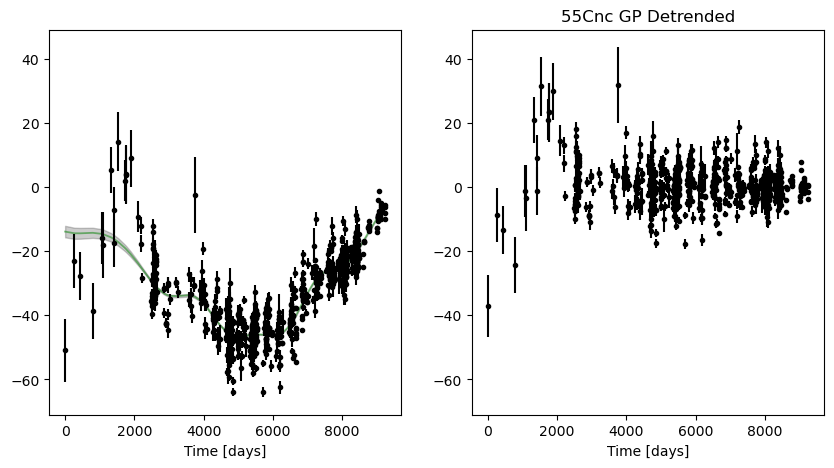

In [22]:
t_GP_final, GP_fit_final = plot_GP(gp_irregular, best_fit_params[len(best_fit_params)-4:], time, kep_res_final, RVerr)

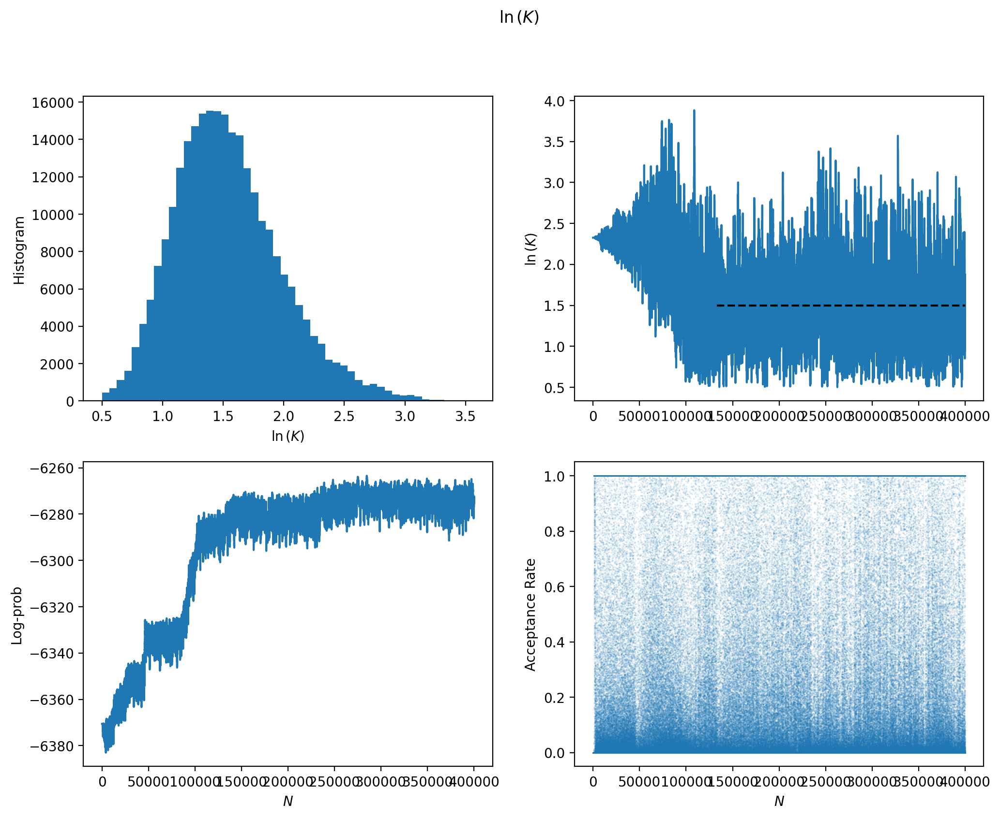

In [23]:
# Some Diagnostic plots
chain_prob = np.loadtxt('caviness/55Cnc_5pGP_MCMC_logprob_alpha_500000000_newamp.txt')
chain_accept = np.loadtxt('caviness/55Cnc_5pGP_MCMC_acceptrate_alpha_500000000_newamp.txt')

N_mcmc = np.arange(0, nsamples+1, 1)
param = len(guess_pars_no_jitter)-4 

fig, axes = plt.subplots(2, 2, sharex=False, figsize = (12, 9), dpi = 200.)   
fig.suptitle(corner_labels[param] )

axes[0, 0].hist(samples[burn:, param], bins = 50)
axes[0, 0].set_ylabel("Histogram")
axes[0, 0].set_xlabel(corner_labels[param])
    
axes[0, 1].plot(N_mcmc[0:], samples[:, param]) 
axes[0, 1].hlines(best_fit_params[param], burn, nsamples, color = 'k', ls = '--')
axes[0, 1].set_ylabel(corner_labels[param])
    
axes[1, 0].plot(N_mcmc, chain_prob)
axes[1, 0].set_ylabel("Log-prob")
    
axes[1, 1].plot(N_mcmc[1:], chain_accept, '.', markersize=0.1)
axes[1, 1].set_ylabel("Acceptance Rate")
axes[1, 0].set_xlabel(r"$N$")
axes[1, 1].set_xlabel(r"$N$")
plt.show()

# Post-hoc Estimation of Jitter

Let $y_n$ denote the observed RV at time $t_n$ with reported uncertainty $\sigma_{y, n}$ and let $f(t_n)$ denote the total model prediction at $t_n$, including all Keplerians in addition to a quasiperiodic GP. We now define a normalized residual $\delta_y \equiv [y_n - f(t_n)]/\sigma_{y, n}$. For a well-fitted model $f(t)$ and well-estimated reported uncertaities $\sigma_{y, n}$, we expect $\delta_y$ to be a close approximation to a standard normal distribution $\mathcal{N}(0, 1)$. But we know the reported uncertainties $\sigma_{y, n}$ do not account for either instrumental or stellar jitter, so in reality our $\delta_y$ distribution will be significantly broader than $\mathcal{N}(0, 1)$.

# A simple approximation for jitter
If jitter didn't exist, we would expect:
\begin{equation}
    \frac{1}{N-\gamma} \sum_{n=0}^{N-1} \Bigg(\frac{y_n - f(t_n)}{\sigma_{y, n}}\Bigg)^2 \approx 1, 
\end{equation}
where $N$ is the number of observations and $\gamma$ is the total number of parameters in the Keplerian+GP model $f(t)$. 
An approximation of jitter $\sigma_J$ could come from:
\begin{equation}
    \frac{1}{N-\gamma} \sum_{n=0}^{N-1} (y_n - f(t_n))^2 \approx \bar{\sigma_y^2} + \sigma_J^2,
\end{equation}
with
\begin{equation}
    \bar{\sigma_y^2} = \frac{1}{N} \sum_{n=0}^{N-1} \sigma_{y, n}^2 .
\end{equation}
We use this rough approximation for the instruments with only very few RV measurements. In these cases, we must further approximate $N-\gamma \approx N$. (Recall, $\gamma = 36$)

In [24]:
res_final = kep_res_final - GP_fit_final
norm_res = res_final/RVerr_Bourrier

jitter_estimate = {}
for inst in np.unique(instruments):
    kinst = instruments == inst
    print(inst)
    MSE = (1./len(res_final[kinst]))*((res_final[kinst]**2)).sum() 
    jitter_estimate[inst] = np.sqrt(MSE - np.mean(RVerr_Bourrier[kinst]**2))
    print("Jitter estimate [m/s]: ", jitter_estimate[inst]) 
    chi_test = (1./len(res_final[kinst]))*((res_final[kinst]**2)/(RVerr_Bourrier[kinst]**2 + jitter_estimate[inst]**2)).sum() 
    print("Resulting mean Chi Sqr: ", chi_test)

HARPN
Jitter estimate [m/s]:  1.0093279452298451
Resulting mean Chi Sqr:  0.9709303347383231
HARPS
Jitter estimate [m/s]:  0.7754209600919234
Resulting mean Chi Sqr:  1.0351880249692753
HRS
Jitter estimate [m/s]:  3.734460299009221
Resulting mean Chi Sqr:  1.074083332395989
KECK
Jitter estimate [m/s]:  3.5040304830519085
Resulting mean Chi Sqr:  0.9813584952120527
LICK
Jitter estimate [m/s]:  7.3779152881044
Resulting mean Chi Sqr:  0.8477165064868094
SOPHIE
Jitter estimate [m/s]:  1.9813034371570053
Resulting mean Chi Sqr:  1.00004060963163
TULL
Jitter estimate [m/s]:  4.79498478047657
Resulting mean Chi Sqr:  0.8432652118791047


In [25]:
for inst in np.unique(instruments):
    kinst = instruments == inst
    norm_res_inst = res_final[kinst]/RVerr_Bourrier[kinst]
    print("#of data points for ", inst, len(norm_res_inst))

#of data points for  HARPN 21
#of data points for  HARPS 12
#of data points for  HRS 63
#of data points for  KECK 216
#of data points for  LICK 290
#of data points for  SOPHIE 38
#of data points for  TULL 142


We take a quick detour to the 4-Keplerian model, to compute estimates of jitter. This is for side-by-side histogram comparisons.

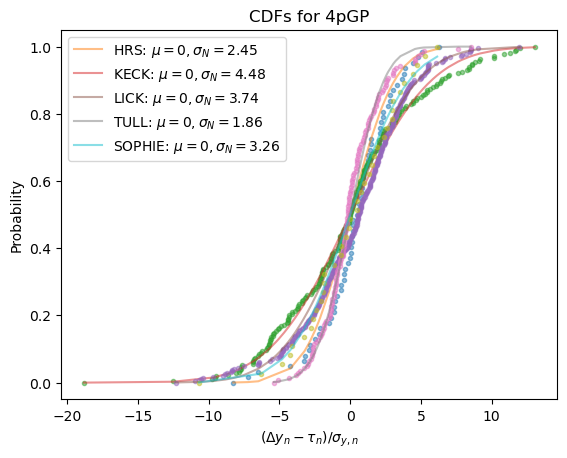

In [36]:
res_final_4pGP = np.loadtxt('text_outputs/final_res_4pGP.txt')
norm_res_4pGP = res_final_4pGP/RVerr_Bourrier

# forcing mean to be zero
def generate_CDF_mean0(x, sig):
    CDF = norm.cdf(x, loc = 0.0, scale=sig)
    return CDF

popt_cdf_mean0_4pGP = {}; pcov_cdf_mean0_4pGP = {}
for inst in ['HRS', 'KECK', 'LICK', 'TULL', 'SOPHIE']:
    kinst = instruments == inst

    vals_new = np.sort(res_final_4pGP[kinst]/RVerr_Bourrier[kinst])
    y_CDF = np.linspace(0, 1, len(res_final_4pGP[kinst])) 
    
    # Fit CDF to data
    popt, pcov = curve_fit(generate_CDF_mean0, vals_new, y_CDF, p0 = [3.0])
    popt_cdf_mean0_4pGP[inst] = popt[0]
    pcov_cdf_mean0_4pGP[inst] = pcov[0]

    plt.plot(vals_new, y_CDF, '.', alpha = 0.5, label = None)
    plt.plot(vals_new, generate_CDF_mean0(vals_new, popt[0]), alpha = 0.5, label = inst + ': $\mu={0:d}, \sigma_N={1:.2f}$'.format(0, popt[0]))

plt.xlabel('$(\Delta y_n - \\tau_{n})/ \sigma_{y, n}$')
plt.ylabel("Probability")
plt.title("CDFs for 4pGP")
plt.legend(loc = 0)
plt.show()
plt.close()

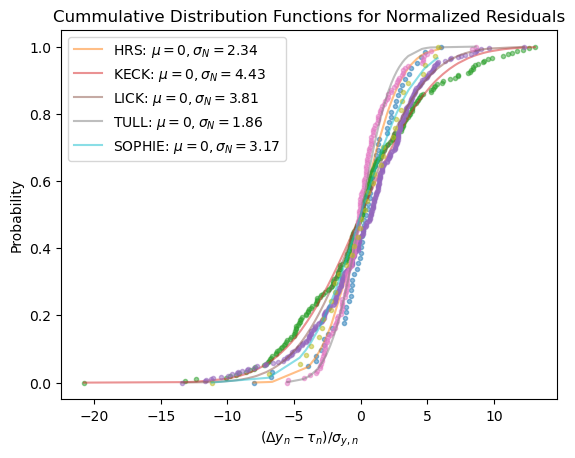

In [37]:
from scipy.stats import norm
from scipy.optimize import curve_fit

# forcing mean to be zero
def generate_CDF_mean0(x, sig):
    CDF = norm.cdf(x, loc = 0.0, scale=sig)
    return CDF

popt_cdf_mean0 = {}; pcov_cdf_mean0 = {}
for inst in ['HRS', 'KECK', 'LICK', 'TULL', 'SOPHIE']:
    kinst = instruments == inst

    vals_new = np.sort(res_final[kinst]/RVerr_Bourrier[kinst])
    y_CDF = np.linspace(0, 1, len(res_final[kinst])) 
    
    # Fit CDF to data
    popt, pcov = curve_fit(generate_CDF_mean0, vals_new, y_CDF, p0 = [3.0])
    popt_cdf_mean0[inst] = popt[0]
    pcov_cdf_mean0[inst] = pcov[0]
    
    plt.plot(vals_new, y_CDF, '.', alpha = 0.5, label = None)
    plt.plot(vals_new, generate_CDF_mean0(vals_new, popt[0]), alpha = 0.5, label = inst + ': $\mu={0:d}, \sigma_N={1:.2f}$'.format(0, popt[0]))

plt.xlabel('$(\Delta y_n - \\tau_{n})/ \sigma_{y, n}$')
plt.ylabel("Probability")
plt.title("Cummulative Distribution Functions for Normalized Residuals")
plt.legend(loc = 0)
plt.show()
plt.close()

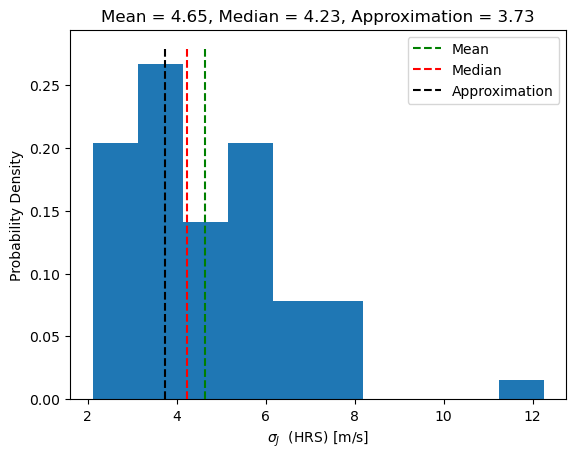

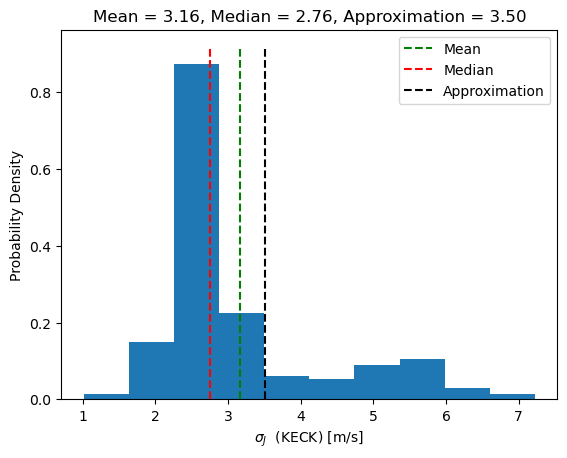

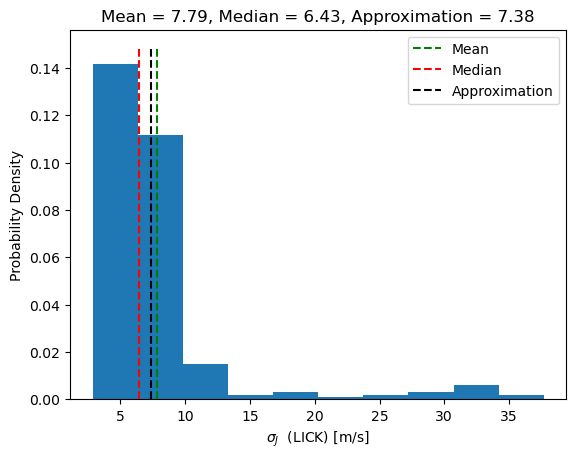

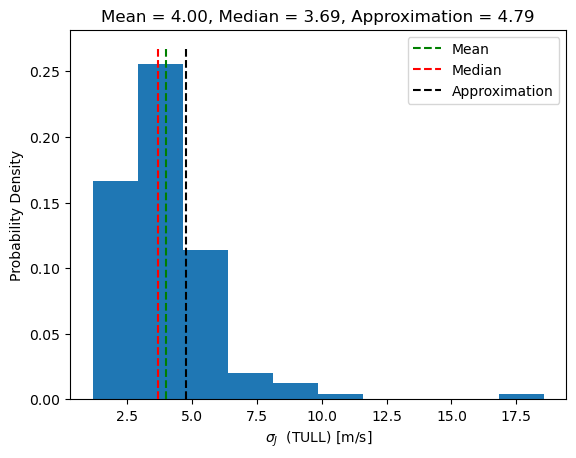

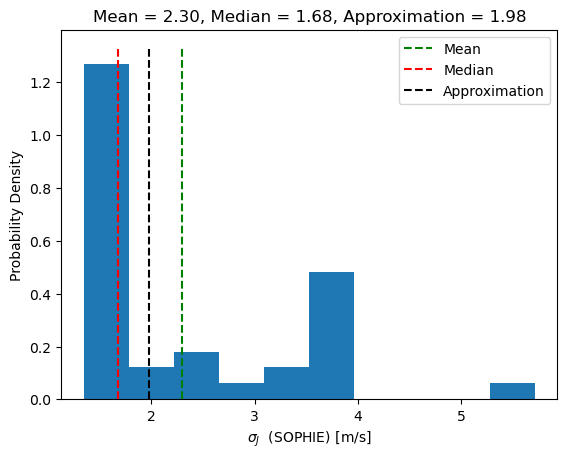

In [28]:
jitter_vec = {}
for inst in ['HRS', 'KECK', 'LICK', 'TULL', 'SOPHIE']:
    kinst = instruments == inst
    jitter_vec[inst] = np.sqrt((popt_cdf_mean0[inst]**2-1) *RVerr_Bourrier[kinst]**2)
    plt.hist(jitter_vec[inst], density=True) # bins = 20,
    ymin, ymax = plt.ylim()
    plt.vlines([np.mean(jitter_vec[inst])], ymin, ymax, color = 'g', ls = '--', zorder = 10, label = "Mean")
    plt.vlines([np.median(jitter_vec[inst])], ymin, ymax, color = 'r', ls = '--', zorder = 12, label = "Median")
    plt.vlines([jitter_estimate[inst]], ymin, ymax, color = 'k', ls = '--', zorder = 14, label = "Approximation")
    plt.title("Mean = {0:.2f}".format(np.mean(jitter_vec[inst])) + ", Median = {0:.2f}".format(np.median(jitter_vec[inst]))+", Approximation = {0:.2f}".format(jitter_estimate[inst]))
    plt.xlabel('$\sigma_J$ ' +' (' +inst+ ') [m/s]')
    plt.ylabel("Probability Density")
    plt.legend(loc = 'upper right')
    plt.show()
    plt.close()

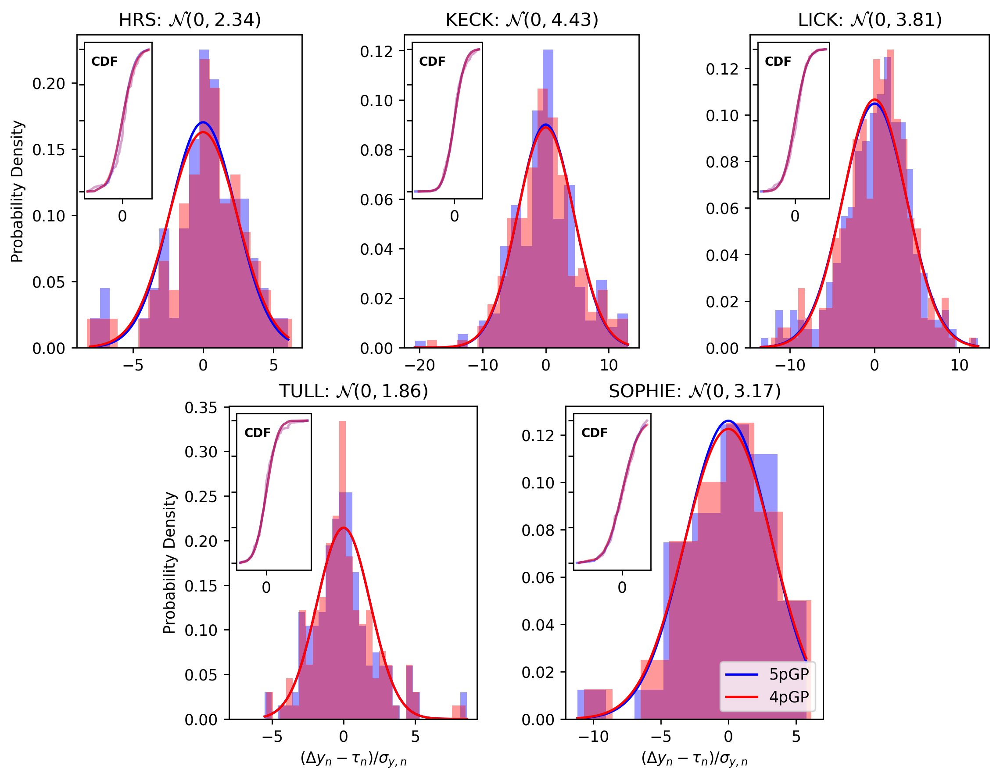

In [29]:
from matplotlib.gridspec import GridSpec
from mpl_toolkits.axes_grid1.inset_locator import inset_axes

fig = plt.figure(layout="constrained", figsize=[9, 7], dpi = 250)

gs = GridSpec(2, 6, figure=fig)
ax1 = fig.add_subplot(gs[0, 0:2])
ax2 = fig.add_subplot(gs[0, 2:4])
ax3 = fig.add_subplot(gs[0, 4:])
ax4 = fig.add_subplot(gs[1, 1:3])
ax5 = fig.add_subplot(gs[1, 3:5])

i = 0
bins_vec = [20, 20, 30, 30, 8]
inst_vec = ['HRS', 'KECK', 'LICK', 'TULL', 'SOPHIE']
for i, ax in enumerate(fig.axes):
    if i == 0 or i == 3:
        ax.set_ylabel("Probability Density")
    inst = inst_vec[i]
    kinst = instruments == inst
    norm_res_inst = res_final[kinst]/RVerr_Bourrier[kinst]
    norm_res_inst_4pGP = res_final_4pGP[kinst]/RVerr_Bourrier[kinst]

    test_x = np.linspace(np.min(norm_res_inst), np.max(norm_res_inst), 1000)

    axins = inset_axes(ax, width="30%", height="50%", loc='upper left')
    ax.hist(norm_res_inst, density=True, bins = bins_vec[i], color = 'blue', alpha = 0.4) 
    ax.hist(norm_res_inst_4pGP, density=True, bins = bins_vec[i], color = 'red', alpha = 0.4) 

    ax.plot(test_x, norm.pdf(test_x, loc=0.0, scale=popt_cdf_mean0[inst]), 'b-', label = "5pGP")
    ax.plot(test_x, norm.pdf(test_x, loc=0.0, scale=popt_cdf_mean0_4pGP[inst]), 'r-', label = '4pGP')

    vals_new = np.sort(res_final[kinst]/RVerr_Bourrier[kinst])
    y_CDF = np.linspace(0, 1, len(res_final[kinst])) 
    
    vals_new_4pGP = np.sort(res_final_4pGP[kinst]/RVerr_Bourrier[kinst])
    y_CDF_4pGP = np.linspace(0, 1, len(res_final_4pGP[kinst])) 
    
    axins.plot(vals_new_4pGP, y_CDF_4pGP, 'b-', alpha = 0.2)
    axins.plot(vals_new_4pGP, y_CDF_4pGP, 'r-', alpha = 0.2)

    axins.plot(vals_new, generate_CDF_mean0(vals_new, popt_cdf_mean0[inst]), 'b-', alpha = 0.5)
    axins.plot(vals_new_4pGP, generate_CDF_mean0(vals_new_4pGP, popt_cdf_mean0_4pGP[inst]), 'r-', alpha = 0.5)
    axins.tick_params(labelleft=False, labelbottom=True)
    axins.set_xticks([0])
    axins.text(0.1, 0.85, "CDF", transform=axins.transAxes, fontweight = 'bold', fontsize = 8) 

    if i == 3:
        ax.set_xlabel('$(\Delta y_n - \\tau_{n})/ \sigma_{y, n}$')
        ax.set_xlim(left = -8)

    ax.set_title(inst + ': '+r'$\mathcal{N}$'+'$({0:d},{1:.2f})$'.format(0, popt_cdf_mean0[inst]))
ax.set_xlabel('$(\Delta y_n - \\tau_{n})/ \sigma_{y, n}$')
ax.legend(loc = 'lower right')
plt.show()
plt.close()

In [35]:
jitter_5pGP = -np.ones(len(time))

for inst in ['HRS', 'KECK', 'LICK', 'TULL', 'SOPHIE']:
    kinst = instruments == inst
    jitter_vec[inst] = np.sqrt((popt_cdf_mean0[inst]**2-1) *RVerr_Bourrier[kinst]**2)
    print("Median Jitter for ", inst, np.median(jitter_vec[inst]))
    jitter_5pGP[kinst] = np.median(jitter_vec[inst])
    
for inst in ['HARPN', 'HARPS']:
    kinst = instruments == inst
    jitter_5pGP[kinst] = jitter_estimate[inst]
    print("Jitter ESTIMATE for ", inst, jitter_estimate[inst])

Median Jitter for  HRS 4.233983594679579
Median Jitter for  KECK 2.757446569083818
Median Jitter for  LICK 6.426272737871636
Median Jitter for  TULL 3.6949869300641036
Median Jitter for  SOPHIE 1.682873146702917
Jitter ESTIMATE for  HARPN 1.0093279452298451
Jitter ESTIMATE for  HARPS 0.7754209600919234


We are now able to compute a reduced $\chi^2$ using our jitter estimates

In [31]:
# Including jitter:
N = len(time)
r_chi_sqr = (1./(N-len(best_fit_params)))*( (res_final**2)/((rv_err+jitter_5pGP)**2) ).sum()
print("Mean chi2: ", r_chi_sqr)
print("chi2: ", ( (res_final**2)/((rv_err+jitter_5pGP)**2) ).sum())

Mean chi2:  0.7959219696464939
chi2:  593.7577893562844


Now that we have a jitter estimate for each instrument, we can plot the components of the 5-Keplerian model that are distinguish it from the 4-Keplerian model - planet d, the GP, and the resulting final RV residual.

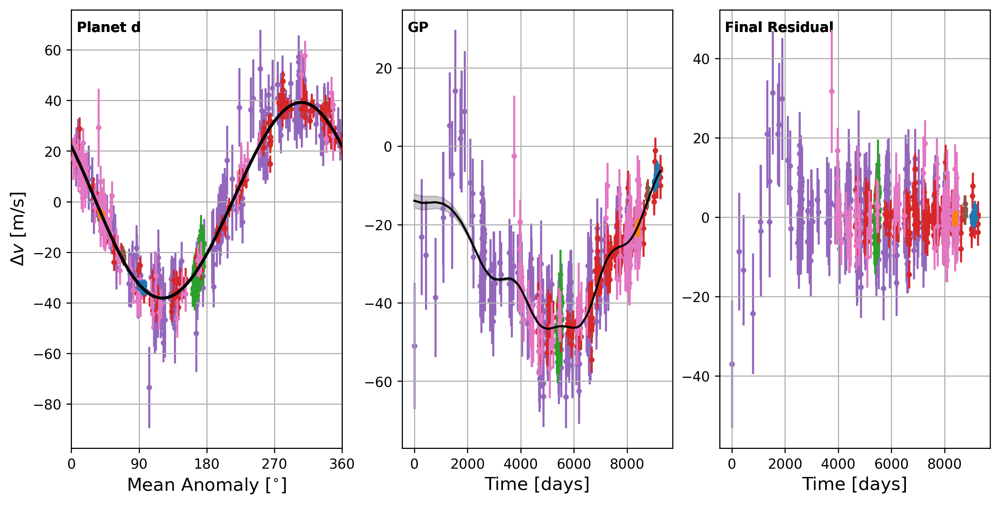

In [32]:
from matplotlib.gridspec import GridSpec

zorder_array = [8, 9, 4, 5, 0, 6, 7]
pred_GP_final, pred_var = gp_irregular.predict(kep_res_final, time, return_var = True)
res_final = kep_res_final - pred_GP_final

L = 1000 # Length of the Mmod array

kep_models = np.zeros((L, len(kep_model.keplerian)))
res_models = np.zeros((len(res), len(kep_model.keplerian)))
M_array = np.zeros((len(res), len(kep_model.keplerian)))
Mmod_array = np.zeros((L, len(kep_model.keplerian)))
n_array = np.zeros(len(kep_model.keplerian))

for name in kep_model.keplerian:
    kep = kep_model.keplerian[name]
    param = kep.get_param()
    kep_model.set_keplerian_param(name, param=['n', 'M0', 'K', 'ecosw', 'esinw'])
    n = kep_model.get_param(f'kep.{name}.n')
    M0 = kep_model.get_param(f'kep.{name}.M0')
    kep_model.set_keplerian_param(name, param=param)
    M = (M0 + n*kep_model.t)*180/np.pi % 360
    Mmod = np.linspace(0,360,L)
    tmod = (Mmod*np.pi/180-M0)/n

    M_array[:, int(name)] = M
    Mmod_array[:, int(name)] = Mmod
    kep_models[:, int(name)] = kep.rv(tmod)
    res_models[:, int(name)] = (res_final+kep.rv(kep_model.t))
    n_array[int(name)] = n

labels = ["Planet b", "Planet c", "Planet f", "Planet e", "Planet d"]
def format_axes(fig):
    for i, ax in enumerate(fig.axes):
        ax.text(0.5, 0.5, "ax%d" % (i+1), va="center", ha="center")
        ax.tick_params(labelbottom=False, labelleft=False)

fig = plt.figure(layout="constrained", figsize = (10, 5), dpi = 250.)

gs = GridSpec(1, 3, figure=fig)
ax1 = fig.add_subplot(gs[0, 0])
ax2 = fig.add_subplot(gs[0, 1])
ax3 = fig.add_subplot(gs[0, 2])

axes = [ax1, ax2, ax3]
for i in range(len(axes)):
    for j in range(len(np.unique(instruments))): 
        inst = np.unique(instruments)[j]
        kinst = rv_dict['ins_name'] == inst
        
        if i == 0:
            axes[i].errorbar(M_array[kinst, 4], res_models[kinst, 4], yerr=(rv_err[kinst]+jitter_5pGP[kinst]), fmt='.', zorder = zorder_array[j], label = inst, rasterized=True)
            axes[i].plot(Mmod_array[:, 4], kep_models[:, 4], 'k', lw=2, rasterized=True, zorder = 15)
            axes[i].set_xlim(0, 360)
            axes[i].text(0.02, 0.95, labels[4], transform=axes[i].transAxes, fontweight = 'bold', fontsize = 10) 
        elif i == 1: 
            axes[i].errorbar(time[kinst], kep_res_final[kinst], yerr=(rv_err[kinst]+jitter_5pGP[kinst]), fmt='.', zorder = zorder_array[j], label = inst, rasterized=True)
            
        elif i == 2: 
            axes[i].errorbar(time[kinst], (kep_res_final-GP_fit_final)[kinst], yerr=(rv_err[kinst]+jitter_5pGP[kinst]), fmt='.', zorder = zorder_array[j], label = inst, rasterized=True)
            axes[i].text(0.02, 0.95, 'Final Residual', transform=axes[i].transAxes, fontweight = 'bold', fontsize = 10) 
    axes[i].grid(visible=True, which='major', axis='both')
    
axes[1].fill_between(time, GP_fit_final - np.sqrt(pred_var), GP_fit_final + np.sqrt(pred_var),
                    color="k", alpha=0.2, zorder = 0)
axes[1].plot(t_GP_final, GP_fit_final, 'k-', label = "GP fit", zorder = 15)
axes[1].text(0.02, 0.95, "GP", transform=axes[1].transAxes, fontweight = 'bold', fontsize = 10) 

axes[2].set_ylim(axes[2].get_ylim())
axes[0].set_xlabel('Mean Anomaly [$^{\circ}$]', fontsize=13)
axes[1].set_xlabel('Time [days]', fontsize=13)
axes[2].set_xlabel('Time [days]', fontsize=13)
axes[0].set_ylabel('$\Delta v$ [m/s]', fontsize=13)
axes[0].set_xticks([0,90,180,270,360], labels=None)
plt.show()
plt.close()

In [33]:
# Astrometric Wobble from 55 Cnc d:
wobble_d = ((2.961*1.898*10**27)/(0.9*1.989*10**30))*(5.420/12.3) # in arcsec
print(wobble_d)

0.0013834118709814545
